In [ ]:
import zipfile
import os

# Re-define the paths after code execution state reset
zip_path = "/content/drive/MyDrive/3dircadmodels.zip"
extract_dir = "/content/drive/MyDrive/3dircadmodels"

# Ensure the target directory exists
os.makedirs(extract_dir, exist_ok=True)

# Attempt to unzip (note: if this path does not exist in the execution environment, it will fail)
try:
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_dir)
    result = f"Unzipped successfully to: {extract_dir}"
except Exception as e:
    result = f"Failed to unzip: {e}"

result


'Unzipped successfully to: /content/drive/MyDrive/3dircadmodels'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!pip install -U tensorflow


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.9/644.9 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 91.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 99.0 MB/s eta 0:00:00
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.4.1
    Uninstalling ml-dtypes-0.4.1:
      Successfully uninstalled ml-dtypes-0.4.1
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.18.0
    Uninstalling tensorboard-2.18.0:
      Successfully uninstalled tensorboard-2.18.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.18.0
    Uninstalling tensorflow-2.18.0:
      Successfully uninstalled tensorflow-2.18.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.18.0 requires tensorflow<2.19,>=2.18, but you have tensorflow 2.19.0 w

##add balck masks

In [ ]:
import os
import shutil
import cv2
import numpy as np
from pathlib import Path

# Re-define input and output paths after reset
masks_input_dir = Path("/content/drive/MyDrive/balanced_data/masks")
images_input_dir = Path("/content/drive/MyDrive/balanced_data/images")

test_images_dir = Path("/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/images")
test_masks_dir = Path("/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/masks")

# Step 1: Find the highest image number in test directory
existing_files = list(test_images_dir.glob("file_*.png"))
max_index = max([int(f.stem.split("_")[1]) for f in existing_files], default=0)

# Step 2: Select 5 black masks (no tumor)
selected_count = 0
new_index = max_index + 1

for mask_path in masks_input_dir.glob("*.png"):
    mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
    if mask is not None and np.sum(mask) == 0:
        # Corresponding image path
        image_path = images_input_dir / mask_path.name
        if image_path.exists():
            # Rename and copy to destination
            new_filename = f"file_{new_index:04d}.png"
            shutil.copy(image_path, test_images_dir / new_filename)
            shutil.copy(mask_path, test_masks_dir / new_filename)
            selected_count += 1
            new_index += 1
        if selected_count == 5:
            break

selected_count, max_index


(0, 565)

#In Evaluation finetube lambda point2\

In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_no_weigts_start_from_scratch_point2.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/images"
mask_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

##cross Evaluation finetube lambda point2\

In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_no_weigts_start_from_scratch_point2.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/images"
mask_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

#in #In Evaluation finetube lambda point oh8

In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_no_weigts_start_from_scratch_point08.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/images"
mask_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

#cross Evaluation finetube lambda point oh8

In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_no_weigts_start_from_scratch_point08.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/images"
mask_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

# in Evaluation finetube lambda point6

In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_no_weigts_start_from_scratch_point6.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/images"
mask_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

# icross Evaluation finetube lambda point6

In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_no_weigts_start_from_scratch_point6.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/images"
mask_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

#in evaluation combined loss(weights
    'dice': 1.0,
    'shape': 0.2,
    'focal': 0.5,
    'l2': 1e-4


In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_combined_loss.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/images"
mask_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

#cross evaluation combined loss(weights
    'dice': 1.0,
    'shape': 0.2,
    'focal': 0.5,
    'l2': 1e-4


In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_combined_loss.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/images"
mask_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

#in evaluation combined loss(weights
    'dice': 0.7,
    'shape': 0.3,     # give more anatomical influence
    'focal': 0.3,
    'l2': 1e-4


In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_combined_loss_2.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/images"
mask_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

#cross evaluation combined loss(weights
    'dice': 0.7,
    'shape': 0.3,     # give more anatomical influence
    'focal': 0.3,
    'l2': 1e-4


In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/3dircadmodels/3dircadmodels/shapeprior_combined_loss_2.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/images"
mask_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

#only main baselin with ross in evaluation

In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/shape_prior_models/shape_prior_models/shapeprior_no_weigts_start_from_scratch.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/images"
mask_dir = "/content/drive/MyDrive/final_split_balanced/final_split_balanced/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

#only main baselin with ross ccross evaluation

In [ ]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/shape_prior_models/shape_prior_models/shapeprior_no_weigts_start_from_scratch.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/images"
mask_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/test/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()



Output hidden; open in https://colab.research.google.com to view.

70/70 ━━━━━━━━━━━━━━━━━━━━ 32s 229ms/step
Overall Dice Score: 0.2345
Overall IoU Score:  0.1328


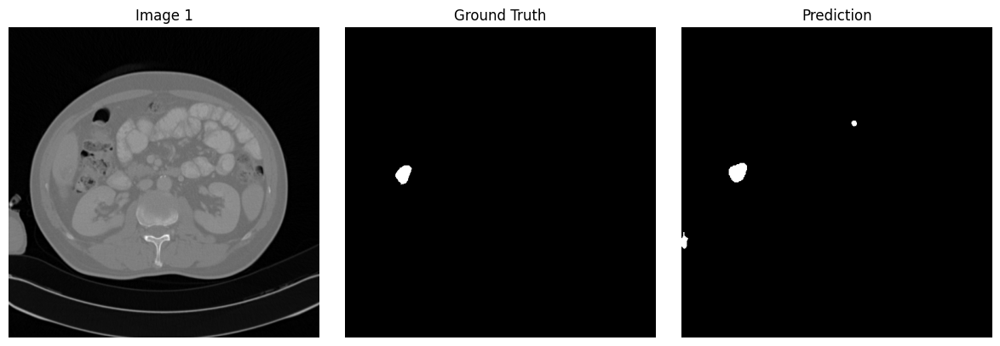

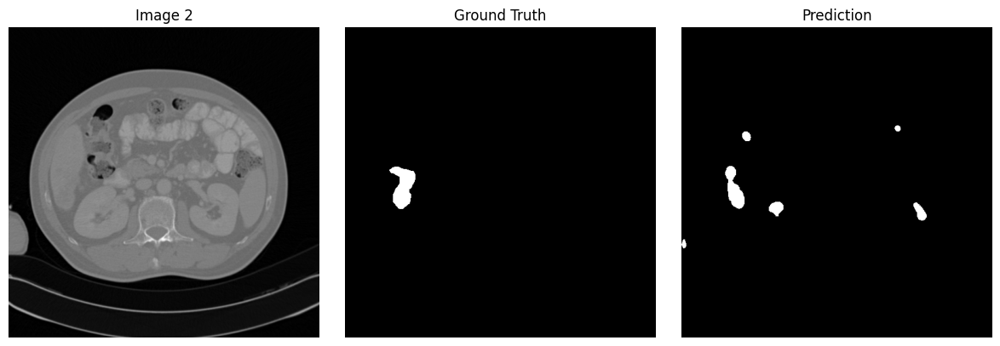

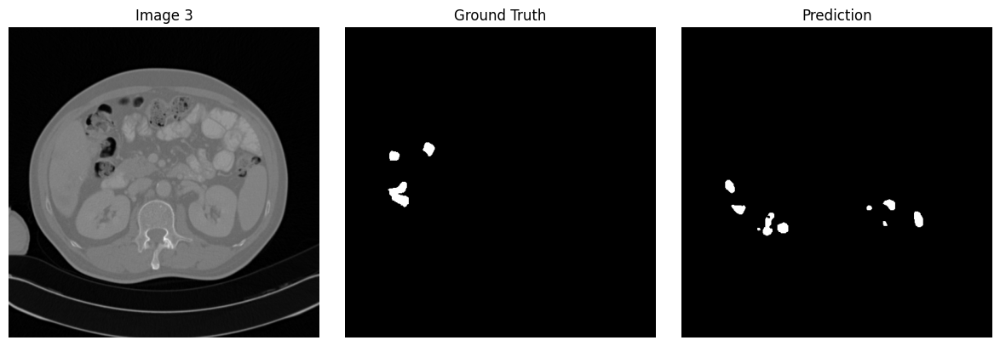

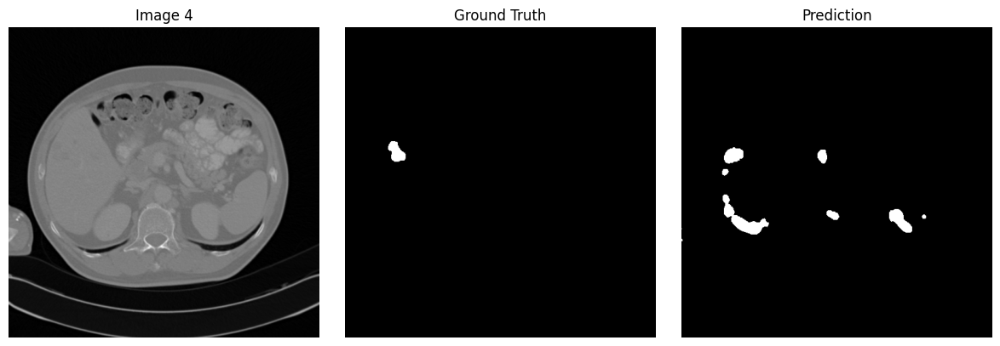

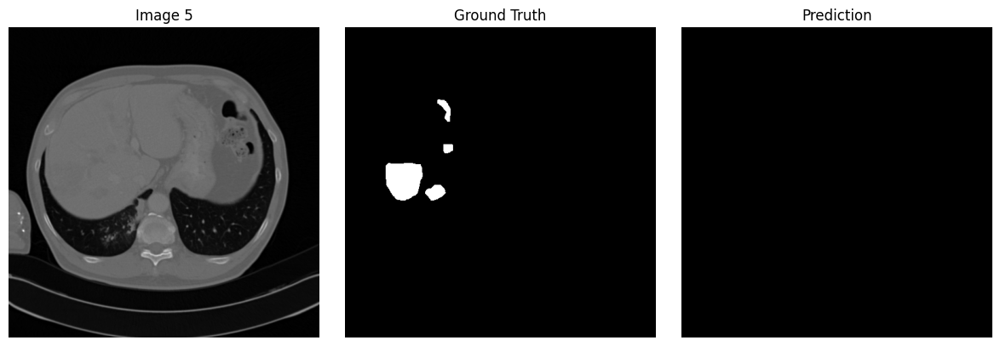

...

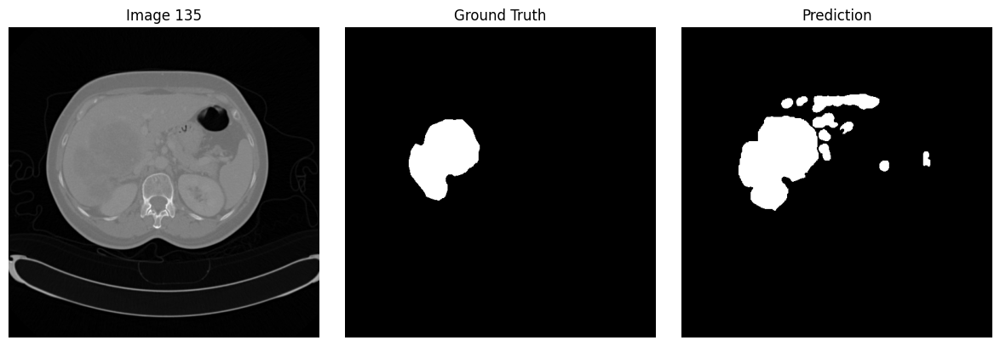

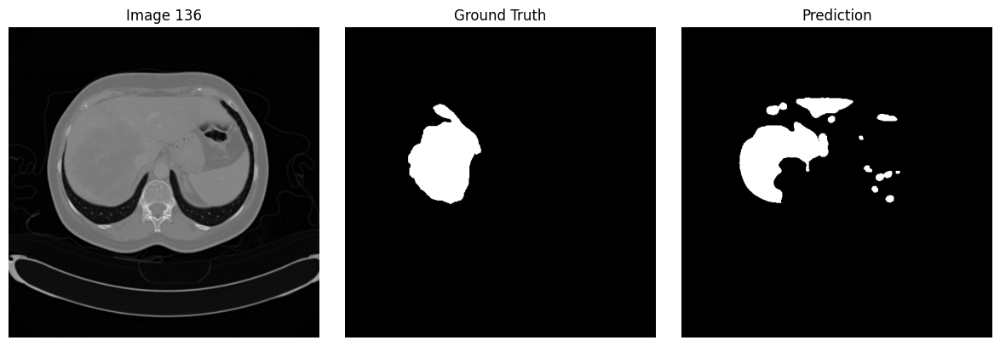

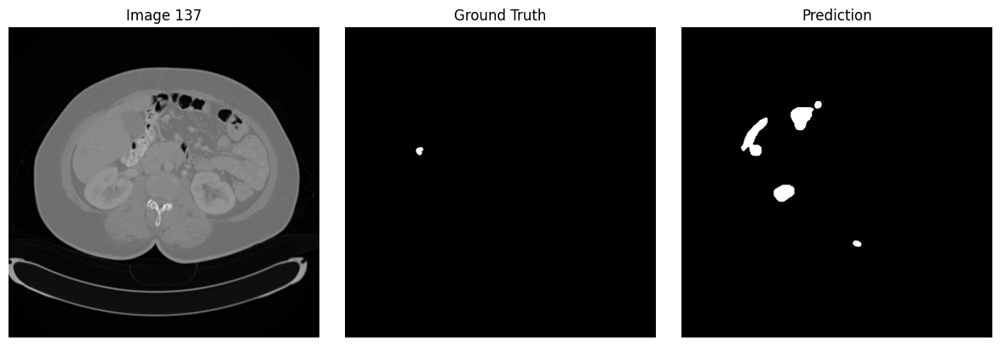

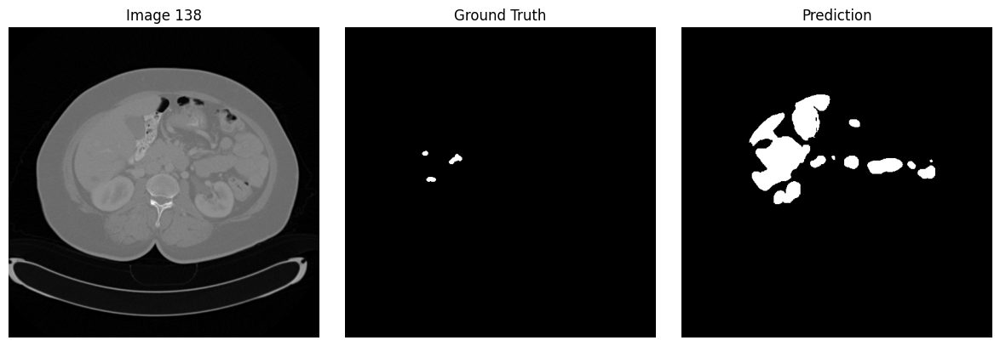

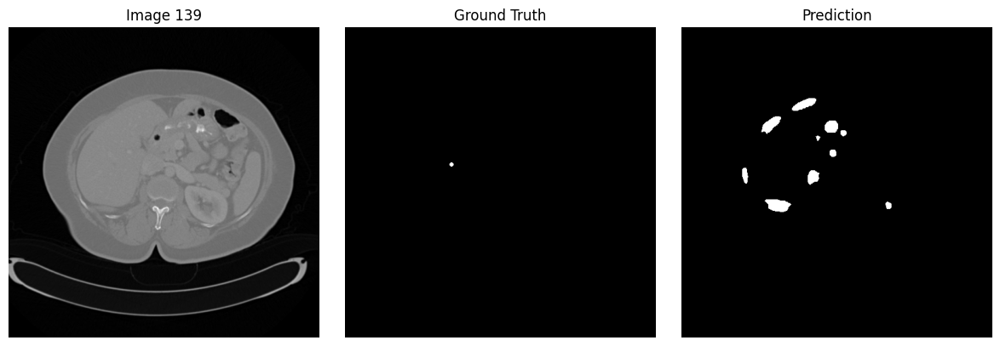

In [2]:
#finetube lambda point 2#
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import importlib.util

# === Load UNet++ Architecture ===
unetpp_path = "/content/drive/MyDrive/workspace/orkspace/UNet-Plus-Plus---Brain-Tumor-Segmentation/UNetPP.py"
spec = importlib.util.spec_from_file_location("UNetPP", unetpp_path)
unetpp_module = importlib.util.module_from_spec(spec)
spec.loader.exec_module(unetpp_module)
UNetPlusPlus = unetpp_module.UNetPlusPlus

# === Build Model and Load Weights ===
input_shape = (512, 512, 1)
model_instance = UNetPlusPlus(input_shape=input_shape)
model = model_instance.BuildNetwork()

model_path = "/content/drive/MyDrive/shape_prior_models/shape_prior_models/shapeprior_no_weigts_start_from_scratch.h5"
model.load_weights(model_path)

# === Load and Preprocess Images and Masks ===
img_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/val/images"
mask_dir = "/content/drive/MyDrive/SQU_split_tumor_80_10_10/val/masks"
img_size = 512

image_ids = sorted([
    f for f in os.listdir(img_dir)
    if f.endswith(".png") and os.path.exists(os.path.join(mask_dir, f))
])

images = []
masks = []

for img_id in image_ids:
    img = cv2.imread(os.path.join(img_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32) / 255.0
    mask = cv2.imread(os.path.join(mask_dir, img_id), cv2.IMREAD_GRAYSCALE).astype(np.float32)
    mask = (mask >= 255).astype(np.float32)

    img = cv2.resize(img, (img_size, img_size), interpolation=cv2.INTER_LINEAR)
    mask = cv2.resize(mask, (img_size, img_size), interpolation=cv2.INTER_NEAREST)

    images.append(np.expand_dims(img, axis=-1))
    masks.append(np.expand_dims(mask, axis=-1))

images = np.array(images)
masks = np.array(masks)

# === Predict and Evaluate ===
preds = model.predict(images, batch_size=2)
preds_bin = (preds > 0.5).astype(np.float32)

def dice_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    return (2. * intersection) / (np.sum(y_true) + np.sum(y_pred) + smooth)

def iou_score(y_true, y_pred, smooth=1e-6):
    intersection = np.sum(y_true * y_pred)
    union = np.sum(y_true) + np.sum(y_pred) - intersection
    return (intersection + smooth) / (union + smooth)

overall_dice = dice_score(masks, preds_bin)
overall_iou = iou_score(masks, preds_bin)

print(f"Overall Dice Score: {overall_dice:.4f}")
print(f"Overall IoU Score:  {overall_iou:.4f}")

# === Visualize All Results ===
for i in range(len(images)):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(images[i].squeeze(), cmap='gray')
    plt.title(f"Image {i+1}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(masks[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(preds_bin[i].squeeze(), cmap='gray')
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

